# Classify3D

## This is the workflow to segment objects in point cloud images, and identify pipes among the clustered objects. 

In [1]:
import laspy
import scipy
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import DBSCAN
from sklearn import metrics
from sklearn import preprocessing
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import path

Load point cloud data. In order to do that, you need laspy package to handle las format data.

In [2]:
inFile = laspy.file.File('data_pipes/data_test1/sample1.las')

Read las data to array, and show the data size. For instruction, the sample data includes half million points. More points can be handled by the algorithms below. 

In [3]:
dataset = np.vstack([inFile.x, inFile.y, inFile.z, inFile.red, inFile.green, inFile.blue]).transpose()
dataset.shape

(500000, 6)

Show the size of 3D box. 

In [4]:
max1 = dataset[:,0].max()
min1 = dataset[:,0].min()

max2 = dataset[:,1].max()
min2 = dataset[:,1].min()

max3 = dataset[:,2].max()
min3 = dataset[:,2].min()

height = max3-min3

print(min1,max1)
print(min2,max2)
print(min3,max3)

503974.0 504004.188
192230.828125 192248.187125
-55.79199981689453 -51.62999981689453


In [5]:
color = dataset[:,3:6]/65535
dataset1 = dataset[:,0:3]

First visualization! Plot the data in notebook! 

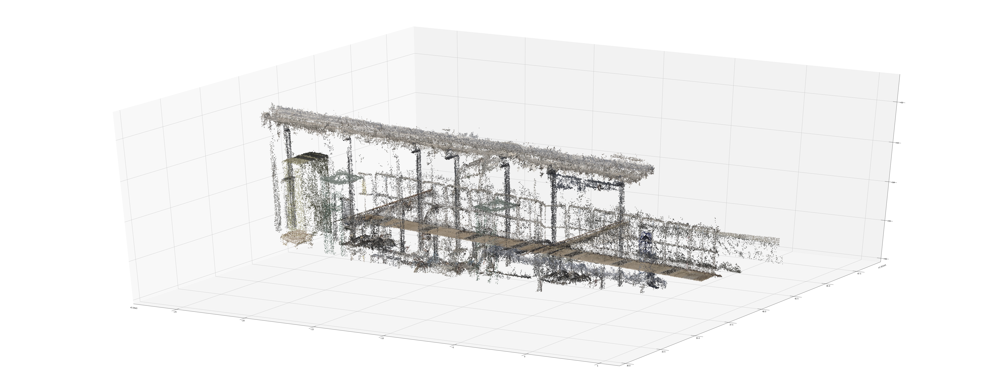

In [6]:
fig = plt.figure(figsize=[100, 40])
ax = fig.add_subplot(111, projection='3d')
col = [0, 0, 1]
ax.scatter(dataset1[:, 0], dataset1[:, 1], dataset1[:, 2], c= color, marker=".")

plt.show()

The following step is only needed to take off group points. I take factor = 0.3 or 0.4 to do that. Since in this workflow example I have already taken off group points, I use factor = 0 instead. So the plot figure is same as the last figure. 

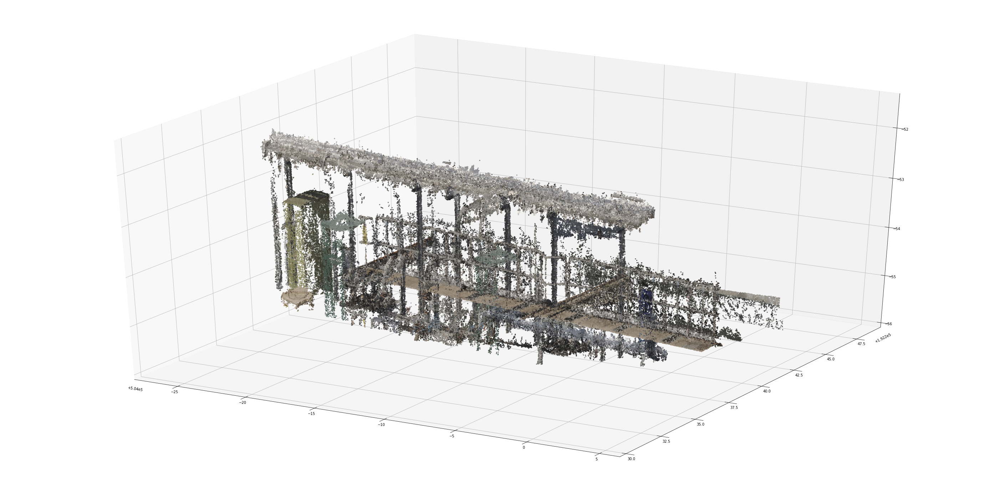

In [7]:
#factor = 0.4
factor = 0.0

dataset2 = dataset1[dataset1[:,2] >= min3 + factor * height]
color2 = color[dataset1[:,2] >= min3 + factor * height]

fig = plt.figure(figsize=[50, 25])
ax = fig.add_subplot(111, projection='3d')
col = [0, 0, 1]
ax.scatter(dataset2[:, 0], dataset2[:, 1], dataset2[:, 2], c= color2, marker=".")

plt.show()

dataset1 = dataset2
color = color2

Check the size of the "off-ground" data.

In [8]:
dataset1.shape

(500000, 3)

## Step 1: Segmentation/Clustering. 

This is one of the crucial step in this workflow. Since the points are not labeled, supervised machine learning tools are not appropriate in this problem. I used unsupervised machine learning algorithm DBSCAN to segment/cluster objects in the image.

In [9]:
clustering = DBSCAN(eps=0.15, min_samples=5, leaf_size=10).fit(dataset1)

Now check the total number of clusters, and number of noise points in the original image.

In [10]:
core_samples_mask = np.zeros_like(clustering.labels_, dtype=bool)
core_samples_mask[clustering.core_sample_indices_] = True
labels = clustering.labels_

n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)
print('Total number of clusters: %d' % n_clusters_)
print('Total number of noise points: %d' % n_noise_)

Total number of clusters: 80
Total number of noise points: 260


Usually the original image contains hundreds even thousands objects! Here I print the number of points in each objects. You can see some objects have many points, but some only have tens points. You do not want to keep them all, just select the major objects. The "top_class" collect the index of the most important objects in the orignal image. Here, I collect six objects, each object is a set of points. 

In [11]:
unique_labels = set(labels)
classfication = []
for k in unique_labels:
    class_member_mask = (labels == k)
    xyz = dataset1[class_member_mask & core_samples_mask]
    classfication.append(len(xyz))
    #print(len(xyz))

print(classfication)
print(max(classfication))

#top_class = np.argsort(classfication)[-5:]

top_class = [classfication.index(x) for x in classfication if x>=0.02 * max(classfication)]
print(top_class)
top_number = len(top_class)

[225143, 219599, 1044, 2356, 5328, 1104, 9047, 4617, 617, 380, 25, 803, 192, 65, 155, 589, 86, 113, 189, 30, 107, 12, 334, 370, 26, 17, 136, 680, 13, 103, 13, 32, 20, 8, 12, 118, 26, 14, 151, 56, 42, 54, 5, 1163, 6, 8, 20, 14, 5, 17, 9, 17, 46, 3, 5, 17, 17, 6, 7, 11, 38, 7, 18232, 54, 5, 7, 2, 278, 5, 1, 12, 2792, 6, 2617, 30, 1, 157, 16, 9, 7, 0]
225143
[0, 1, 4, 6, 7, 62]


Now time for plotting! -- to plot the top objects from the original image. Remember that you have already gotten rid off most objects and noisy points. 

0 (0.9914648212226067, 0.677354863514033, 0.37808535178777386, 1.0)
225143
1 (0.9976163014225298, 0.9261053440984237, 0.6250672818146866, 1.0)
219599
4 (0.9211841599384853, 0.9684736639753941, 0.6260668973471745, 1.0)
5328
6 (0.6122260668973474, 0.8438292964244523, 0.6439830834294502, 1.0)
9047
7 (0.27204921184159936, 0.6180699730872741, 0.7061130334486736, 1.0)
4617
62 (0.3686274509803922, 0.30980392156862746, 0.6352941176470588, 1.0)
18232


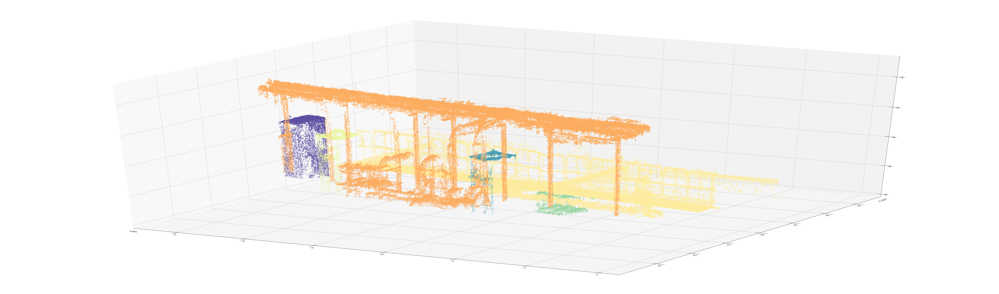

In [12]:
from matplotlib.axes._axes import _log as matplotlib_axes_logger
matplotlib_axes_logger.setLevel('ERROR')

fig = plt.figure(figsize=[100, 30])
ax = fig.add_subplot(111, projection='3d')
unique_labels = set(labels)

colors = [plt.cm.Spectral(each)
  for each in np.linspace(0.3, 1, top_number)]

#print(colors)

for i,col in zip(range(0,top_number),colors):
    k = top_class[i]
    print(k,col)
    class_member_mask = (labels == k)
    
    #print(k,class_member_mask)
    if k in top_class:
    #if k == 1:
        xyz = dataset1[class_member_mask & core_samples_mask]
        print(len(xyz))
        ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col, marker=".")

plt.show()

## Welcome to the next step. Step 2: classification. 

You need to find which object is pipe, which are not! You can probably decide them by eye, but an automatic method is necessary for machine to make decisions. I first do 2D projections. The 2D images of them are as follows. 

225143
219599
5328
9047
4617
18232


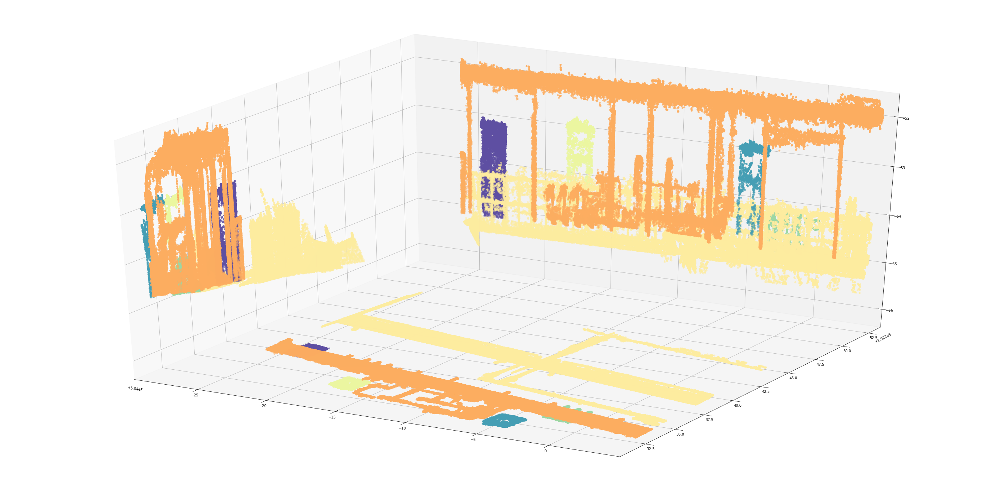

In [13]:
fig = plt.figure(figsize=[50, 25])
ax = fig.add_subplot(111, projection='3d')
unique_labels = set(labels)
colors = [plt.cm.Spectral(each)
  for each in np.linspace(0.3, 1, top_number)]

for i,col in zip(range(0,top_number),colors):
    k = top_class[i]
    if k == -1:
        # Black used for noise.
        col = [0, 0, 1]
    class_member_mask = (labels == k)
    
    #print(k,class_member_mask)
    if k in top_class:
    #if k == 0:
        xyz = dataset1[class_member_mask & core_samples_mask]
        print(len(xyz))
        
        xflat = np.full_like(xyz[:, 0], min1-3)
        yflat = np.full_like(xyz[:, 1], max2+5)
        zflat = np.full_like(xyz[:, 2], min3-0.5)
        
        ax.scatter(xflat, xyz[:, 1], xyz[:, 2], c=col)
        ax.scatter(xyz[:, 0], yflat, xyz[:, 2], c=col)
        ax.scatter(xyz[:, 0], xyz[:, 1], zflat, c=col)
        
        #ax.plot(xyz[:, 0], xyz[:, 1], c=col, zdir='z', zs=min3-0.5)
        #ax.plot(xyz[:, 0], xyz[:, 2], c=col, marker=".", markersize=0.01, zdir='y', zs= max2)
        #ax.plot(xyz[:, 1], xyz[:, 2], c=col, marker=".", markersize=0.1, zdir='x', zs= min1)
        
        ax.set_xlim([min1-3, max1])
        ax.set_ylim([min2, max2+5])
        ax.set_zlim([min3-0.5, max3])
plt.show()

Now it is the time to use openCV. I use ORB technique to find similarities among objects. The principle is like this: you have many 2D projected images from different objects.  Also, you have a pre-selected 2D image marked as a 2D pipe, now you need to find the similarities between the marked 2D pipe and all 2D projections. 

I first plot the marked 2D pipes. This pre-selected image is a xy-plane pipe projection from another part of the raw big 3D image. You can use other 2D pipe image of course. 

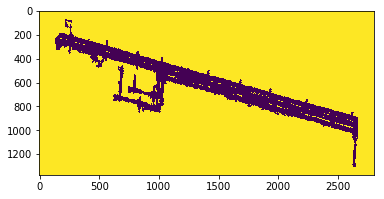

In [14]:
from numpy.polynomial.polynomial import polyfit
from matplotlib.backends.backend_agg import FigureCanvasAgg as FigureCanvas
import cv2
import warnings

path_sample = 'pipe_images/pipe07.2.png'
img_sample = cv2.imread(path_sample, cv2.IMREAD_GRAYSCALE)

plt.imshow(img_sample)

Next I show the xy-plane projections shown in In[13]. Black-and-white is great. Fake-color is removed.

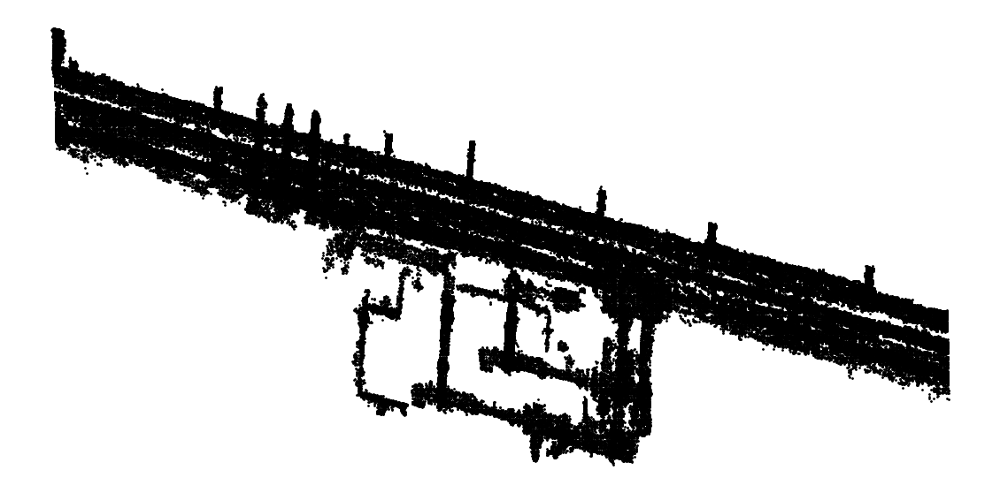

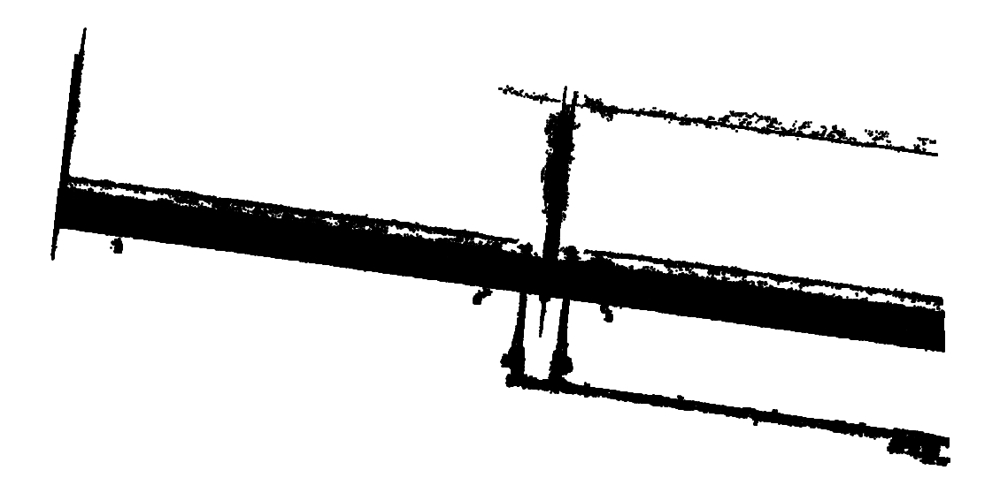

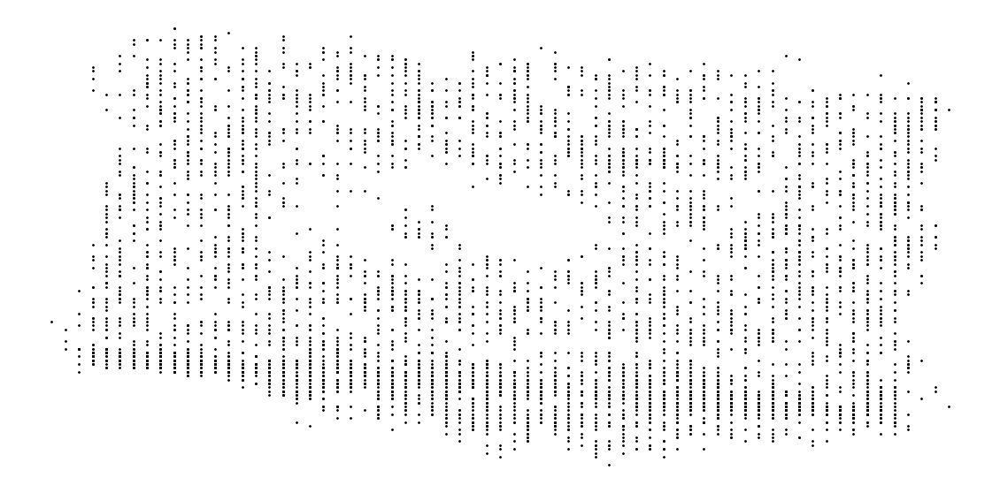

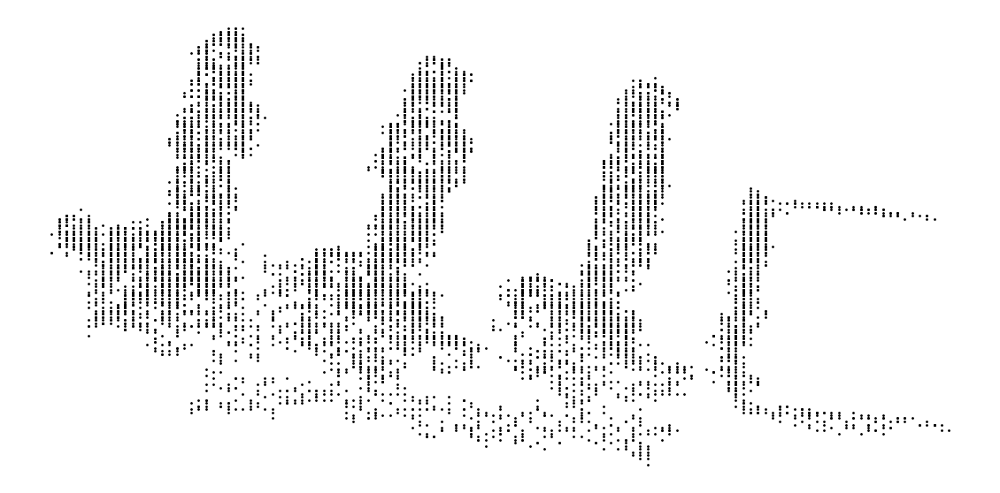

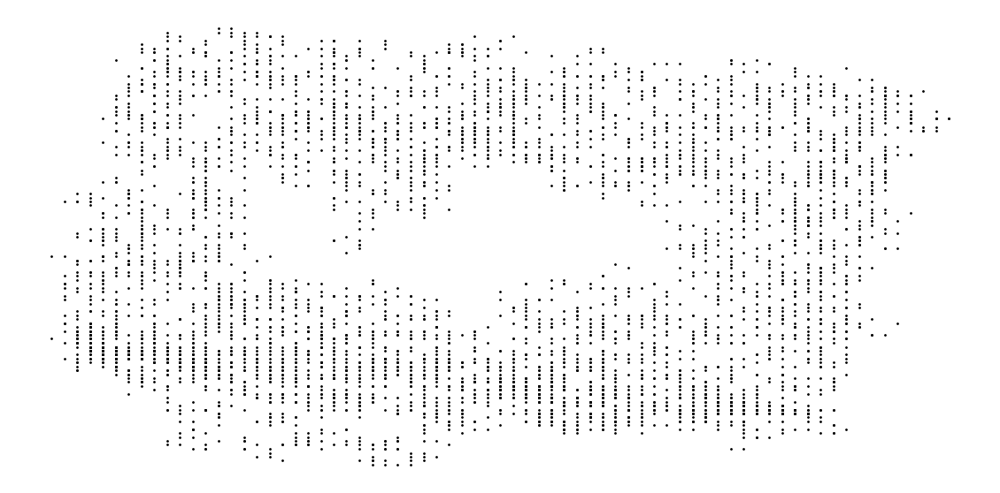

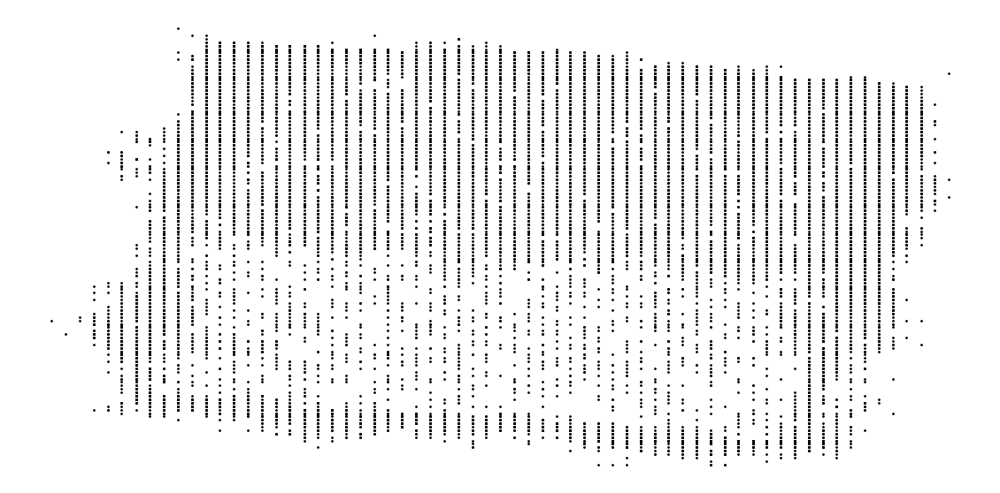

In [15]:
image_tot = [[0]]*len(top_class)
fig = [[0]]*len(top_class)

warnings.simplefilter("ignore", DeprecationWarning)

#for k, col in zip(unique_labels, colors):
for i in range(0,top_number):
    
    fig[i] = plt.figure(figsize=[20, 10])
    ax = fig[i].add_subplot(111)
    
    canvas = FigureCanvas(fig[i])
    
    k = top_class[i]
    class_member_mask = (labels == k)
    
    #print(k,class_member_mask)
    if k in top_class:
    #if k==4:
        xyz = dataset1[class_member_mask & core_samples_mask]
        
        XX = xyz[:,0]
        YY = xyz[:,1]
        ZZ = xyz[:,2]
        
        YY2D = YY
        
        #XX_lenth = XX.max()-XX.min()
        #YY_lenth = YY.max()-YY.min()
        #ZZ_lenth = ZZ.max()-ZZ.min()
        
        ax.scatter(XX, YY2D, c='k', s=3)
        # Turn off tick labels
        ax.set_yticklabels([])
        ax.set_xticklabels([])
        ax.axis('off')
        
        canvas.draw()     
        
        image = np.fromstring(fig[i].canvas.tostring_rgb(), dtype=np.uint8, sep='')
        image = image.reshape(fig[i].canvas.get_width_height()[::-1] + (3,))
        image_tot[i] = cv2.cvtColor(image,cv2.COLOR_RGB2BGR)
        


Some projected objects look weird, some are not. Now we compare the above projections to the pre-selected pipe image. Great, let us score the similarity between them. The first class with index 0 has the best score. Actually this is a 2D projection of a pipe.

In [16]:
# to select the clustering indices which are pipelines

path_sample = 'pipe_images/pipe07.2.png'
img_sample = cv2.imread(path_sample, cv2.IMREAD_GRAYSCALE)


#pipe_index = []

score_max = 0.0
pipe_index = 0

for i in range(0,len(top_class)):
    
    img_compare = image_tot[i]
    
    orb = cv2.ORB_create()
    
    kp_a, desc_a = orb.detectAndCompute(img_sample, None)
    kp_b, desc_b = orb.detectAndCompute(img_compare, None)
    
    # initialize the bruteforce matcher
    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

    # match.distance is a float between {0:100} - lower means more similar
    matches = bf.match(desc_a, desc_b)
    similar_regions = [i for i in matches if i.distance < 35]
    if len(matches) == 0:
        print(0)
    score = len(similar_regions)/len(matches)
    print(i,score)
    if (score > score_max) :
        pipe_index  = top_class[i]
        score_max = score
    
print(pipe_index,score_max)

0 0.29739776951672864
1 0.25120772946859904
2 0.005494505494505495
3 0.022727272727272728
4 0.0
5 0.0
0 0.29739776951672864


Since you find the 2D projection with the best score, you can go back to select its 3D information. This is a pipe. You have selected a pipe. This is the basic idea to automatically select a pipe in a 3D image. Let us plot it!

225143


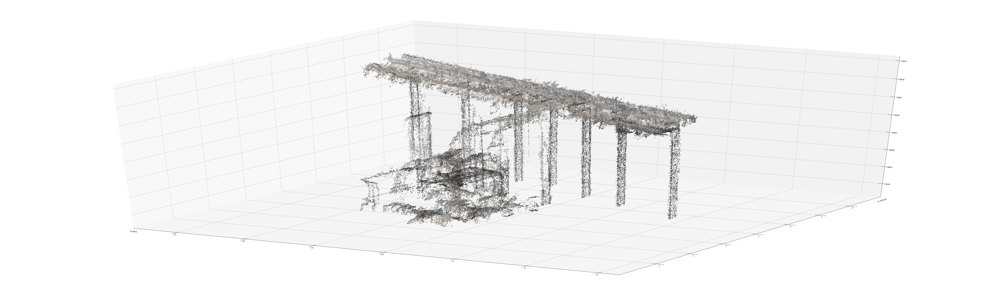

In [17]:
fig = plt.figure(figsize=[100, 30])
ax = fig.add_subplot(111, projection='3d')

colors = [plt.cm.Spectral(each)
  for each in np.linspace(0.3, 1, top_number)]

#print(colors)

for i,col in zip(range(0,top_number),colors):
    k = top_class[i]
    #print(k,col)
    class_member_mask = (labels == k)
    #col_pipe = color[class_member_mask & core_samples_mask]
    
    if k == pipe_index:
    #if k == 1:
        xyz = dataset1[class_member_mask & core_samples_mask]
        col_pipe = color[class_member_mask & core_samples_mask]
        print(len(xyz))
        ax.scatter(xyz[:, 0], xyz[:, 1], xyz[:, 2], c=col_pipe, marker=".")

plt.show()

pipe_data = xyz

Now you can save the pipe using pandas. The pipe data is saved in sample1.csv. You can use other tool such as CloudCompare to open csv files. It is there, you can check it!

In [18]:
import pandas as pd 

pipe_csv = np.concatenate((pipe_data, col_pipe * 255), axis=1)
pipe_csv.shape
pd.DataFrame(pipe_csv).to_csv('data_pipes/data_test1/sample1.csv')

## Step 3: Validation. 

Okay. We have find pipe(s). Now let us to validate it. A good way to do that is that you can labeled the pipe in the original image by hand (using tool such as CloudCompare). Then you compare the pipe found in this workflow to the labeled pipe by other tool. Of course this is not a standard way to do the validation, but since we do not have many samples and many pipes, this is a quantivate way to check our code. 

Read the labeled data: 

In [19]:
inFile_label = laspy.file.File('data_pipes/data_test1/labeled1.las')
dataset_label = np.vstack([inFile_label.x, inFile_label.y, inFile_label.z, inFile_label.red, inFile_label.green, inFile_label.blue]).transpose()

color_label = dataset_label[:,3:6]/65535
dataset_label = dataset_label[:,0:3]
dataset_label.shape

(200969, 3)

Interestingly, make a plot to show the overlapping between the pipe here (pipe_data) and the hand-labeled pipe by other tool. Looks like quite similar? But not exactly the same. 

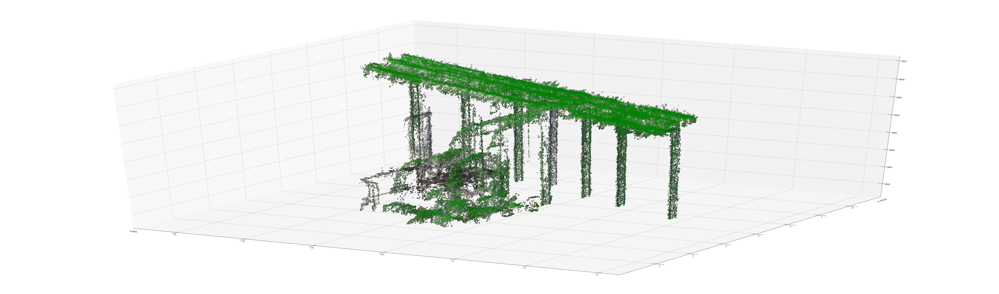

In [20]:
fig = plt.figure(figsize=[100, 30])
ax = fig.add_subplot(111, projection='3d')
col = [0, 0, 1]
ax.scatter(dataset_label[:, 0], dataset_label[:, 1], dataset_label[:, 2], c= 'g', s=5,marker=".")
ax.scatter(pipe_data[:, 0], pipe_data[:, 1], pipe_data[:, 2], c= col_pipe, s=100, marker=".")
#plt.title('Estimated number of cluster: %d' % n_clusters_)
plt.show()

Use pandas to find the overlapping between the two point sets, and find the overlapping score. 

In [21]:
np.set_printoptions(formatter={'float_kind':'{:f}'.format})

data_test = pd.DataFrame(data=pipe_data).round(2)
data_label = pd.DataFrame(data=dataset_label).round(2)

print(data_test.head())
print(data_label.head())

overlap = pd.concat([data_test,data_label])
overlap = overlap.drop_duplicates(keep=False)

score = 1-overlap.shape[0]/data_test.shape[0]

print("The score is: ", score)

           0          1      2
0  503990.84  192234.55 -52.20
1  503974.00  192238.48 -55.10
2  503974.03  192238.47 -54.33
3  503992.94  192231.91 -53.34
4  503986.03  192235.80 -52.00
           0          1      2
0  503990.84  192234.55 -52.20
1  503992.94  192231.91 -53.34
2  503986.03  192235.80 -52.00
3  504002.00  192233.27 -52.08
4  503987.06  192232.50 -53.76
The score is:  0.9210679434848075


## Step 4: Further Clustering!

Further clustering is also possible! I use Gaussian Mixture to further cluster the selected pipes. You can separate the real pipe from the supported branches. 

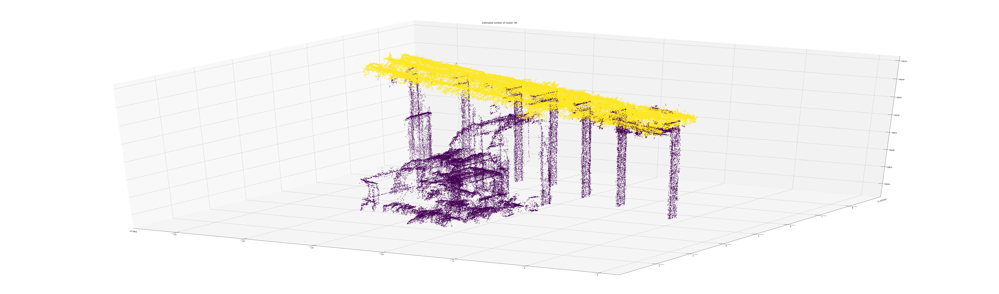

In [22]:
from sklearn.mixture import GaussianMixture

gmm = GaussianMixture(n_components=2).fit(pipe_data).predict(pipe_data)

fig = plt.figure(figsize=[100, 30])
ax = fig.add_subplot(111, projection='3d')

ax.scatter(pipe_data[:, 0], pipe_data[:, 1], pipe_data[:, 2], c=gmm, marker=".")

plt.title('Estimated number of cluster: %d' % n_clusters_)
plt.show()

And make a plot, using the original color for the pipe. Hurray, you got it! But the better plot please use the saved csv file, and the pipeline please use the .py file. 

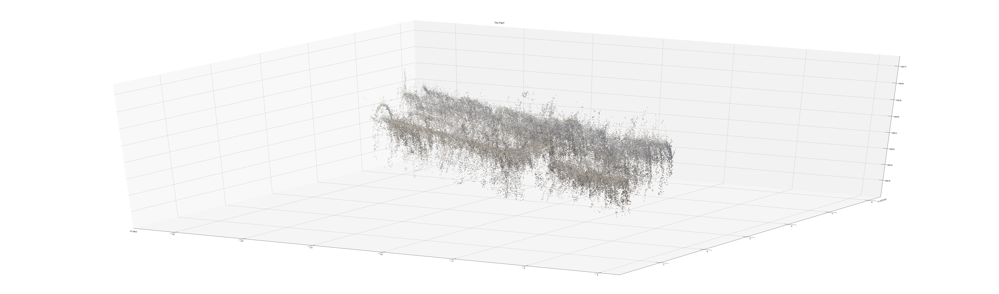

In [24]:
group1_index = np.where(gmm == 0)
group2_index = np.where(gmm == 1)

pipe_data1 = pipe_data[group1_index]
pipe_data2 = pipe_data[group2_index]

col_pipe1 = col_pipe[group1_index]
col_pipe2 = col_pipe[group2_index]

fig = plt.figure(figsize=[100, 30])
ax = fig.add_subplot(111, projection='3d')

#ax.scatter(pipe_data1[:, 0], pipe_data1[:, 1], pipe_data1[:, 2], c=col_pipe1, marker=".")
ax.scatter(pipe_data2[:, 0], pipe_data2[:, 1], pipe_data2[:, 2], c=col_pipe2, marker=".")

plt.title('The Pipe!')
plt.show()